In [ ]:
# Cell 1: Import Libraries and Set Up
import os
import json
import re
import numpy as np
import nltk
import enchant
from collections import Counter
from pygments import lex
from pygments.lexers import get_lexer_by_name, find_lexer_class
from pygments.token import Token
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('words')

stop_words = set(stopwords.words('english'))
lemmatizer = WordNetLemmatizer()
english_dict = enchant.Dict("en_US")



In [ ]:
# Cell 2: Define Functions for Comment Extraction and Preprocessing

def extract_comments_from_file(file_path, language):
    comments = []
    with open(file_path, 'r', encoding='utf-8', errors='ignore') as file:
        code = file.read()
        if language == "Jupyter Notebook":
            language = "Python"
        lexer = get_lexer_by_name(language)
        tokens = list(lex(code, lexer))
        for token_type, token_value in tokens:
            if token_type in Token.Comment:
                comments.append(token_value.strip())
    return comments

def extract_comments_and_count_lines(file_path, language):
    comments = []
    code_lines = 0
    comment_lines = 0

    with open(file_path, 'r', encoding='utf-8', errors='ignore') as file:
        code = file.read()
        if language == "Jupyter Notebook":
            language = "Python"
        lexer = get_lexer_by_name(language)
        tokens = lex(code, lexer)
        for token_type, token_value in tokens:
            if token_type in Token.Comment.Multiline:
                comments.append(token_value.strip())
                comment_lines += token_value.count('\n') + 1
            elif token_type in Token.Comment:
                comments.append(token_value.strip())
                comment_lines += 1
            elif token_type in Token.Text and token_type not in TokenType.Whitespace:
                code_lines += 1
    
    return comments, code_lines, comment_lines

def preprocess_text(text):
    text = re.sub(r'\W+', ' ', text)
    tokens = word_tokenize(text.lower())
    tokens = [lemmatizer.lemmatize(token) for token in tokens if token not in stop_words and english_dict.check(token)]
    return ' '.join(tokens)

def get_extensions(language):
    # Define extensions for supported languages
    extensions = {
        "Python": [".py"],
        "JavaScript": [".js"],
        "Java": [".java"],
        "Jupyter Notebook": [".ipynb"],
        "C++": [".cpp", ".h"],
        "R": [".r"],
        "LiveScript": [".ls"],
        "Fortran": [".f", ".f90"],
        "C": [".c", ".h"],
        "C#": [".cs"],
        "Go": [".go"],
        "Ruby": [".rb"],
        "Rust": [".rs"],
        "Swift": [".swift"],
        "Kotlin": [".kt"],
        "Scala": [".scala"],
        "PHP": [".php"],
        "TypeScript": [".ts"],
        "Mathematica": [".nb"],
        "Perl": [".pl"],
        "Haskell": [".hs"],
        "Lua": [".lua"],
        "Julia": [".jl"],
        "Shell": [".sh"],
        "Objective-C": [".m"],
        # Add more languages and their extensions here
    }
    return extensions.get(language, [])

In [26]:
# Cell 3: Repository Processing Functions

def process_repository(directory, language, repo_name):
    if not get_extensions(language):
        return {repo_name: "Can't process"}

    all_comments = ''

    for root, _, files in os.walk(directory):
        for file in files:
            if any(file.endswith(ext) for ext in get_extensions(language)):
                file_path = os.path.join(root, file)
                comments = extract_comments_from_file(file_path, language)
                all_comments += ' '.join(comments)
    
    # Preprocess comments and combine them into a single string
    flat_comments =  preprocess_text(all_comments)
    
    return {repo_name: flat_comments}

def process_repository2(directory, language, repo_name):
    if not get_extensions(language):
        return {repo_name: "Can't process"}

    all_comments = []
    total_code_lines = 0
    total_comment_lines = 0

    for root, _, files in os.walk(directory):
        for file in files:
            if any(file.endswith(ext) for ext in get_extensions(language)):
                file_path = os.path.join(root, file)
                comments, code_lines, comment_lines = extract_comments_and_count_lines(file_path, language)
                all_comments.extend(comments)
                total_code_lines += code_lines
                total_comment_lines += comment_lines

    token_counts = Counter()
    for comment in all_comments:
        tokens = preprocess_text(comment)
        token_counts.update(tokens)

    total_lines = total_code_lines + total_comment_lines
    comment_coverage = (total_comment_lines / total_lines) * 100 if total_lines > 0 else 0

    return {repo_name: {"comment_coverage": comment_coverage}}

In [32]:
#Cell 4: Analyze Repositories
def analyze_repositories(base_directory, repo_languages):
    results = {}

 
   
    for repo in os.listdir(base_directory):
        

        repo_path = os.path.join(base_directory, repo)
        if os.path.isdir(repo_path):
            print(f"Processing {repo}")
            language = repo_languages.get(repo, "UnsupportedLanguage")
            is_supported = get_extensions(language) != []
            if not is_supported:
                print(f"Can't process {repo} as it is not a supported language")
                results[repo] = "Can't process"
            else:
                repo_results = process_repository2(repo_path, language, repo)
                results.update(repo_results)
    return results

In [33]:
# Cell 5: Main Execution

base_directory = 'data/repos/'

try:
    with open('repo-languages.json', 'r') as f:
        repo_languages = json.load(f)
except FileNotFoundError:
    print(f"Error: The file '{repo_languages_file}' was not found.")
    raise

results = analyze_repositories(base_directory, repo_languages)

with open('repository_coverage.json', 'w', encoding='utf-8') as outfile:
    json.dump(results, outfile, ensure_ascii=False, indent=4)

# print average comment coverage
comment_coverage = [v['comment_coverage'] for v in results.values() if isinstance(v, dict)]
average_comment_coverage = np.mean(comment_coverage)
print(f"Average Comment Coverage: {average_comment_coverage:.2f}%")



print("Analysis complete. Results saved to repository_comments.json")

Processing 0tt3r
Processing 1234zou
Processing 3T
Processing 510004015
Processing 7enTropy7
Processing 89996462
Processing aa75017730
Processing aarontrowbridge
Can't process aarontrowbridge as it is not a supported language
Processing abdullahkhalids
Processing absolute-quantum
Processing acheong08
Processing AdhesionTek
Processing advancesoftcorp
Processing AgnostiqHQ
Processing AI4Finance-Foundation
Processing aiidateam
Processing ajz34
Processing alejomonbar
Processing alexandersgreen
Processing alibaba
Processing Alice-Bob-SW
Processing alpha87
Processing amartyabose
Processing amazon-braket
Processing amazon-braket-examples
Processing amcdawes
Processing AminKaramlou
Processing amschel99
Processing amyami187
Can't process amyami187 as it is not a supported language
Processing Andrew-S-Rosen
Processing anedumla
Processing Anish-M-code
Processing anonymousr007
Can't process anonymousr007 as it is not a supported language
Processing Antimonit
Processing antontutoveanu
Processing any

In [29]:
# Cell 6: Step 1: Define keywords v1
keywords = {
    "General Quantum Algorithms": [
    "algorithm",
    "search",
    "walk",
    "Fourier transform",
    "phase estimation",
    "hidden subgroup problem",
    "speedup",
    "optimization",
    "teleportation",
    "アルゴリズム",
    "検索",
    "ウォーク",
    "フーリエ変換",
    "位相推定",
    "隠れ部分群問題",
    "スピードアップ",
    "最適化",
    "テレポーテーション",
    "算法",
    "搜索",
    "行走",
    "傅里叶变换",
    "相位估计",
    "隐藏子群问题",
    "加速",
    "优化",
    "量子传送",
  ],
  "Grover's Algorithm": [
    "grover",
    "amplitude amplification",
    "search",
    "algorithm",
    "グローバー",
    "振幅増幅",
    "検索",
    "アルゴリズム",
    "格罗夫",
    "幅值放大",
    "搜索",
    "算法",
  ],
  "Shor's Algorithm": [
    "shor",
    "algorithm",
    "shor's algorithm",
    "fraction",
    "fractals",
    "factorization",
    "integer factorization",
    "period finding",
    "order finding",
    "discrete logarithm",
    "RSA",
    "elliptic curve",
    "cryptography",
    "safe",
    "resistant",
    "ショア",
    "アルゴリズム",
    "ショアのアルゴリズム",
    "分数",
    "フラクタル",
    "因数分解",
    "整数因数分解",
    "周期探索",
    "順序探索",
    "離散対数",
    "楕円曲線",
    "暗号",
    "安全",
    "耐性",
    "肖尔",
    "算法",
    "肖尔算法",
    "分数",
    "分形",
    "因数分解",
    "整数因数分解",
    "周期发现",
    "序列发现",
    "离散对数",
    "RSA",
    "椭圆曲线",
    "密码学",
    "安全",
    "抗性",
  ],
  "Variational Quantum Eigensolver (VQE)": [
    "variational eigensolver",
    "algorithm",
    "vqe",
    "chemistry",
    "変分固有値求解器",
    "アルゴリズム",
    "vqe",
    "化学",
    "变分特征值求解器",
    "算法",
    "vqe",
    "化学",
  ],
  "Quantum Approximate Optimization Algorithm (QAOA)": [
    "approximate optimization algorithm",
    "qaoa",
    "optimization",
    "algorithm",
    "maxcut",
    "traveling salesman",
    "tsp",
    "combinatorial optimization",
    "graph partitioning",
    "scheduling",
    "routing",
    "近似最適化アルゴリズム",
    "qaoa",
    "最適化",
    "アルゴリズム",
    "最大カット",
    "巡回セールスマン",
    "tsp",
    "組合せ最適化",
    "グラフ分割",
    "スケジューリング",
    "ルーティング",
    "近似优化算法",
    "qaoa",
    "优化",
    "算法",
    "最大割",
    "旅行推销员",
    "tsp",
    "组合优化",
    "图划分",
    "调度",
    "路由",
  ],
  "HHL Algorithm": [
    "hhl algorithm",
    "linear systems",
    "matrix inversion",
    "algorithm",
    "hhlアルゴリズム",
    "線形システム",
    "行列反転",
    "アルゴリズム",
    "hhl算法",
    "线性系统",
    "矩阵求逆",
    "算法",
  ],
  "Deutsch-Jozsa Algorithm": [
    "deutsch-jozsa",
    "balanced function",
    "algorithm",
    "ドイチョジョーザ",
    "バランス関数",
    "アルゴリズム",
    "德意志-乔萨",
    "平衡函数",
    "算法",
  ],
  "Simon's Algorithm": [
    "simon",
    "simon’s algorithm",
    "periodicity",
    "hidden period",
    "algorithm",
    "サイモン",
    "サイモンのアルゴリズム",
    "周期性",
    "隠れた周期",
    "アルゴリズム",
    "西蒙",
    "西蒙算法",
    "周期性",
    "隐藏周期",
    "算法",
  ],
  "General Quantum Cryptography": [
    "security",
    "cryptography",
    "encryption",
    "secure direct communication",
    "post-cryptography",
    "network",
    "repeater",
    "hacking",
    "side-channel attack",
    "bit commitment",
    "digital signatures",
    "secret sharing",
    "secure comunication",
    "safe",
    "resistant",
    "セキュリティ",
    "暗号",
    "暗号化",
    "安全な直接通信",
    "ポスト暗号",
    "ネットワーク",
    "リピーター",
    "ハッキング",
    "サイドチャネル攻撃",
    "ビットコミットメント",
    "デジタル署名",
    "秘密共有",
    "安全な通信",
    "安全",
    "耐性",
    "安全",
    "密码学",
    "加密",
    "安全直接通信",
    "后密码学",
    "网络",
    "中继器",
    "黑客",
    "侧信道攻击",
    "比特承诺",
    "数字签名",
    "秘密共享",
    "安全通信",
    "安全",
    "抗性",
  ],
  "Quantum key distirbution ": [
    "quantum key distirbution",
    "security",
    "bb84",
    "b92",
    "single-photon QKD",
    "cryptography",
    "key distribution",
    "qkd",
    "encryption",
    "Alice",
    "Bob",
    "Eve",
    "e91",
    "entanglement-based QKD",
    "entanglement",
    "ekert protocol",
    "量子鍵配送",
    "セキュリティ",
    "bb84",
    "b92",
    "単一光子QKD",
    "暗号",
    "鍵配送",
    "qkd",
    "暗号化",
    "アリス",
    "ボブ",
    "イブ",
    "e91",
    "エンタングルメントベースのQKD",
    "エンタングルメント",
    "エッカートプロトコル",
    "量子密钥分发",
    "安全",
    "bb84",
    "b92",
    "单光子QKD",
    "密码学",
    "密钥分发",
    "qkd",
    "加密",
    "爱丽丝",
    "鲍勃",
    "伊芙",
    "e91",
    "基于纠缠的QKD",
    "纠缠",
    "埃克特协议",
  ],
  "Quantum Simulation": [
    "hamiltonian simulation",
    "wavefunction",
    "many-body systems",
    "phase transition",
    "dynamics",
    "Monte Carlo",
    "lattice models",
    "fermionic simulation",
    "bosonic simulation",
    "chemistry",
    "variational eigensolver",
    "vqe",
    "unitary coupled cluster",
    "molecular dynamics",
    "field theory",
    "digital simulation",
    "analog simulation",
    "chaos",
    "adiabatic simulation",
    "walk",
    " cellular automata",
    "ハミルトニアンシミュレーション",
    "波動関数",
    "多体システム",
    "相転移",
    "ダイナミクス",
    "モンテカルロ",
    "格子モデル",
    "フェルミオンシミュレーション",
    "ボソンシミュレーション",
    "化学",
    "変分固有値求解器",
    "vqe",
    "ユニタリー結合クラスター",
    "分子動力学",
    "場の理論",
    "デジタルシミュレーション",
    "アナログシミュレーション",
    "カオス",
    "断熱シミュレーション",
    "ウォーク",
    "セルラーオートマトン",
    "哈密顿模拟",
    "波函数",
    "多体系统",
    "相变",
    "动力学",
    "蒙特卡洛",
    "格子模型",
    "费米子模拟",
    "玻色子模拟",
    "化学",
    "变分特征值求解器",
    "vqe",
    "单元耦合簇",
    "分子动力学",
    "场论",
    "数字模拟",
    "模拟模拟",
    "混沌",
    "绝热模拟",
    "行走",
    "细胞自动机",
  ],
  "Quantum Hardware": [
    "superconducting",
    "trapped ions",
    "topological qubit",
    "decoherence",
    "error correction",
    "surface code",
    "chip",
    "Josephson junction",
    "annealer",
    "processor",
    "transducer",
    "hybrid systems",
    "memristor",
    "超伝導",
    "トラップされたイオン",
    "トポロジカルキュービット",
    "デコヒーレンス",
    "エラー修正",
    "表面コード",
    "チップ",
    "ジョセフソン接合",
    "アニーラー",
    "プロセッサ",
    "トランスデューサー",
    "ハイブリッドシステム",
    "メムリスタ",
    "超导",
    "捕获离子",
    "拓扑量子比特",
    "去相干",
    "纠错",
    "表面代码",
    "芯片",
    "约瑟夫森结",
    "退火器",
    "处理器",
    "换能器",
    "混合系统",
    "忆阻器",
  ],
  "Quantum Machine Learning": [
    "neural networks",
    "qnn",
    "support vector machine",
    "qsvm",
    "clustering",
    "principal component analysis",
    "qpca",
    "Boltzmann machine",
    "qbms",
    "generative adversarial networks",
    "qgans",
    "hybrid classical machine learning",
    "data encoding",
    "feature mapping",
    "kernel estimation",
    "unsupervised learning",
    "reinforcement learning",
    "autoencoders",
    "classifier",
    "regression",
    "data",
    "ニューラルネットワーク",
    "qnn",
    "サポートベクターマシン",
    "qsvm",
    "クラスタリング",
    "主成分分析",
    "qpca",
    "ボルツマンマシン",
    "qbms",
    "生成対抗ネットワーク",
    "qgans",
    "ハイブリッド古典機械学習",
    "データエンコーディング",
    "特徴マッピング",
    "カーネル推定",
    "教師なし学習",
    "強化学習",
    "オートエンコーダ",
    "分類器",
    "回帰",
    "データ",
    "神经网络",
    "qnn",
    "支持向量机",
    "qsvm",
    "聚类",
    "主成分分析",
    "qpca",
    "玻尔兹曼机",
    "qbms",
    "生成对抗网络",
    "qgans",
    "混合经典机器学习",
    "数据编码",
    "特征映射",
    "核估计",
    "无监督学习",
    "强化学习",
    "自动编码器",
    "分类器",
    "回归",
    "数据",
  ],
  "Quantum Communication": [
    "communication protocols",
    "coherent communication",
    "modulation",
    "communication complexity",
    "internet",
    "repeater",
    "router",
    "network",
    "channel",
    "link",
    "relay",
    "bridge",
    "satellite",
    "通信プロトコル",
    "コヒーレント通信",
    "変調",
    "通信複雑性",
    "インターネット",
    "リピーター",
    "ルーター",
    "ネットワーク",
    "チャネル",
    "リンク",
    "リレー",
    "ブリッジ",
    "衛星",
    "通信协议",
    "相干通信",
    "调制",
    "通信复杂性",
    "互联网",
    "中继器",
    "路由器",
    "网络",
    "通道",
    "链接",
    "中继",
    "桥接器",
    "卫星",
  ],
  "Quantum Computer Tooling and Frameworks": [
    "development kit",
    "QDK",
    "SDK",
    "IDE",
    "programming environment",
    "emulation",
    "design",
    "circuit optimization",
    "gate library",
    "error correction tools",
    "debugging",
    "visualization tools",
    "benchmarking",
    "hardware integration",
    "cloud service",
    "API",
    "開発キット",
    "QDK",
    "SDK",
    "IDE",
    "プログラミング環境",
    "エミュレーション",
    "設計",
    "回路最適化",
    "ゲートライブラリ",
    "エラー修正ツール",
    "デバッグ",
    "可視化ツール",
    "ベンチマーク",
    "ハードウェア統合",
    "クラウドサービス",
    "API",
    "开发套件",
    "QDK",
    "SDK",
    "IDE",
    "编程环境",
    "仿真",
    "设计",
    "电路优化",
    "门库",
    "纠错工具",
    "调试",
    "可视化工具",
    "基准测试",
    "硬件集成",
    "云服务",
    "API",
  ],
  "Quantum Computer Simulation": [
    "computing simulator",
    "computer simulation",
    "state vector simulation",
    "computer emulation",
    "circuit simulation",
    "hardware simulation",
    "system simulation",
    "software simulation",
    "virtual computer",
    "computing simulator",
    "emulator",
    "computing emulation",
    "circuit emulator",
    "state simulator",
    "gate simulator",
    "processor simulation",
    "algorithm simulation",
    "コンピューティングシミュレーター",
    "コンピュータシミュレーション",
    "状態ベクトルシミュレーション",
    "コンピュータエミュレーション",
    "回路シミュレーション",
    "ハードウェアシミュレーション",
    "システムシミュレーション",
    "ソフトウェアシミュレーション",
    "仮想コンピュータ",
    "コンピューティングシミュレーター",
    "エミュレータ",
    "コンピューティングエミュレーション",
    "回路エミュレータ",
    "状態シミュレーター",
    "ゲートシミュレーター",
    "プロセッサシミュレーション",
    "アルゴリズムシミュレーション",
    "计算模拟器",
    "计算机模拟",
    "状态矢量模拟",
    "计算机仿真",
    "电路模拟",
    "硬件模拟",
    "系统模拟",
    "软件模拟",
    "虚拟计算机",
    "计算模拟器",
    "仿真器",
    "计算仿真",
    "电路仿真器",
    "状态仿真器",
    "门仿真器",
    "处理器仿真",
    "算法模拟",
  ],
  "Learning Project": [
    "tutorial",
    "example",
    "learning project",
    "educational",
    "beginner",
    "introduction",
    "getting started",
    "hands-on",
    "course",
    "workshop",
    "training",
    "sample code",
    "demo",
    "guide",
    "instructional",
    "lesson",
    "walkthrough",
    "exercises",
    "teaching",
    "learning module",
    "チュートリアル",
    "例",
    "学習プロジェクト",
    "教育",
    "初心者",
    "イントロダクション",
    "入門",
    "ハンズオン",
    "コース",
    "ワークショップ",
    "トレーニング",
    "サンプルコード",
    "デモ",
    "ガイド",
    "指導",
    "レッスン",
    "ウォークスルー",
    "演習",
    "教育",
    "学習モジュール",
    "教程",
    "示例",
    "学习项目",
    "教育",
    "初学者",
    "介绍",
    "入门",
    "实践",
    "课程",
    "研讨会",
    "培训",
    "示例代码",
    "演示",
    "指南",
    "教学",
    "课程",
    "演练",
    "练习",
    "教学",
    "学习模块",
  ],
}





In [30]:
import re
from collections import Counter
from itertools import chain
from jarowinkler import *


def preprocess_text(text):
    text = text.lower()  # Convert text to lowercase
    text = re.sub(r'\W+', ' ', text)  # Remove punctuation and special characters
    tokens = text.split()
    # Remove single characters and digits
    tokens = [token for token in tokens if len(token) > 1 and not token.isdigit()]
    return tokens

def generate_ngrams(tokens, n):
    ngrams = zip(*[tokens[i:] for i in range(n)])
    return [" ".join(ngram) for ngram in ngrams]

def extract_ngrams(text):
    tokens = preprocess_text(text)
    unigrams = tokens
    bigrams = generate_ngrams(tokens, 2)
    trigrams = generate_ngrams(tokens, 3)
    return unigrams + bigrams + trigrams

def classify_text(text, keyword_dict, threshold, exact_match_bonus):
    ngrams = extract_ngrams(text)
    category_scores = {category: 0 for category in keyword_dict}

    for ngram in ngrams:
        for category, keywords in keyword_dict.items():
            exact_match_found = False
            for keyword in keywords:
                if ngram == keyword:  # Check for exact match
                    print(f"Exact match found: {ngram} in {keyword} cat {category}")
                    category_scores[category] += exact_match_bonus
                    exact_match_found = True
                    break
            if not exact_match_found:  # Proceed with similarity check only if no exact match
                for keyword in keywords:
                    similarity = jarowinkler_similarity(ngram, keyword)
                    if similarity >= threshold:
                        print(f"Matched: {ngram} to {keyword} similarity {similarity} in {category}")
                        category_scores[category] += similarity

    # Determine the best category
    best_category = max(category_scores, key=category_scores.get)
    if category_scores[best_category] == 0:
        return "No match found", category_scores

    return best_category, category_scores


def aggregate_comments(repo_comments):
    # Combine all comments into a single string
    combined_comments = ' '.join(repo_comments)
    return combined_comments





In [31]:
def classify_repositories(repositories, keyword_dict, threshold, exact_match_bonus):
    repo_classifications = {}
    for repo_name, comments in repositories.items():
        category_name, scores = classify_text(comments, keyword_dict, threshold, exact_match_bonus)

        repo_classifications[repo_name] = category_name, scores
    return repo_classifications

repositories = {}
with open('repository_comments.json', 'r') as f:
    repositories = json.load(f)

# Classify repositories
repo_classifications = classify_repositories(repositories, keywords, threshold=0.88, exact_match_bonus=3)
for repo, category in repo_classifications.items():
    print(f"Repository: {repo}, Category: {category}")

Matched: core to course similarity 0.9111111111111111 in Learning Project
Matched: core to course similarity 0.9111111111111111 in Learning Project
Matched: core to course similarity 0.9111111111111111 in Learning Project
Matched: work to workshop similarity 0.9 in Learning Project
Matched: trace to transducer similarity 0.8833333333333334 in Quantum Hardware
Matched: trace to transducer similarity 0.8833333333333334 in Quantum Hardware
Matched: routine to routing similarity 0.9428571428571428 in Quantum Approximate Optimization Algorithm (QAOA)
Matched: routine to router similarity 0.9095238095238095 in Quantum Communication
Matched: trace to transducer similarity 0.8833333333333334 in Quantum Hardware
Matched: trace to transducer similarity 0.8833333333333334 in Quantum Hardware
Matched: tracing to training similarity 0.9083333333333333 in Learning Project
Matched: tracing to teaching similarity 0.8821428571428571 in Learning Project
Matched: trace to transducer similarity 0.88333333

KeyboardInterrupt: 

In [ ]:
# Save results to a JSON file
with open('repository_classifications.json', 'w', encoding='utf-8') as outfile:
    json.dump(repo_classifications, outfile, ensure_ascii=False, indent=4)

{'0tt3r': ['Learning Project', {'General Quantum Algorithms': 55.83525252525251, "Grover's Algorithm": 55.83525252525251, "Shor's Algorithm": 26.815329311211674, 'Variational Quantum Eigensolver (VQE)': 1.81, 'Quantum Approximate Optimization Algorithm (QAOA)': 22.18727272727273, 'HHL Algorithm': 76.94673566629453, 'Deutsch-Jozsa Algorithm': 1.81, "Simon's Algorithm": 1.81, 'General Quantum Cryptography': 12.23650793650794, 'Quantum key distirbution ': 0, 'Quantum Simulation': 112.89759436469934, 'Quantum Hardware': 68.35560275368731, 'Quantum Machine Learning': 35.9, 'Quantum Communication': 8.933187318033866, 'Quantum Computer Tooling and Frameworks': 22.071441934261635, 'Quantum Computer Simulation': 83.12405248460985, 'Learning Project': 184.4429482554484}], '1-part': ['Quantum Hardware', {'General Quantum Algorithms': 0, "Grover's Algorithm": 0, "Shor's Algorithm": 0, 'Variational Quantum Eigensolver (VQE)': 0, 'Quantum Approximate Optimization Algorithm (QAOA)': 0, 'HHL Algorithm

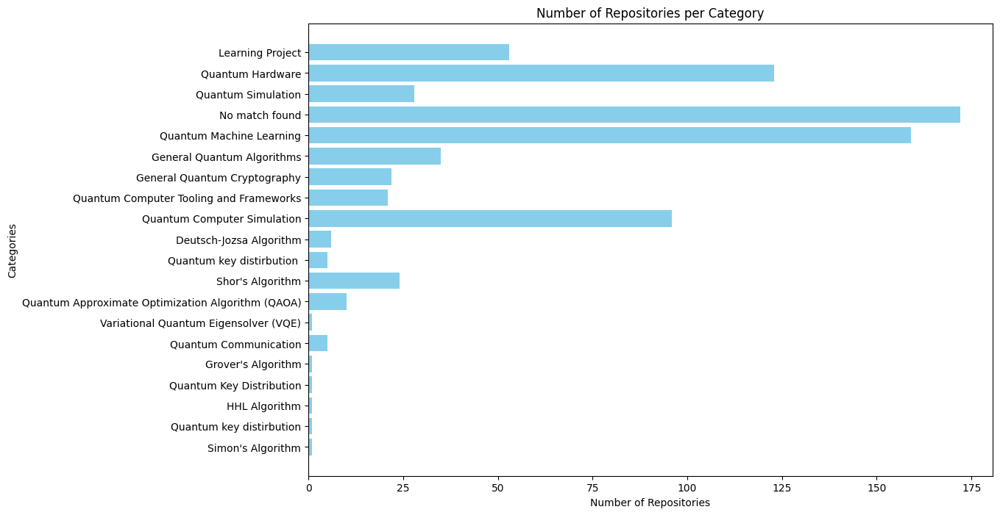

<Figure size 640x480 with 0 Axes>

In [ ]:
# Load the repository classifications from the JSON file

import json
import matplotlib.pyplot as plt

with open('repository_classifications.json', 'r') as f:
    results = json.load(f)

print(results)


# Step 1: Aggregate the counts
category_counts = {}
for repo_name, (assigned_category, category_scores) in results.items():
    if assigned_category not in category_counts:
        category_counts[assigned_category] = 0
    category_counts[assigned_category] += 1

# Step 2: Create a bar chart
def plot_category_counts(category_counts):
    categories = list(category_counts.keys())
    counts = list(category_counts.values())

    plt.figure(figsize=(12, 8))
    plt.barh(categories, counts, color='skyblue')
    plt.xlabel('Number of Repositories')
    plt.ylabel('Categories')
    plt.title('Number of Repositories per Category')
    plt.gca().invert_yaxis()
    plt.show()
    # save
    plt.savefig('category_counts.png')
    
plot_category_counts(category_counts)




